In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report
from sklearn.linear_model import LogisticRegression
from imblearn.over_sampling import SMOTE
from sklearn.tree import DecisionTreeClassifier

all_data = pd.read_csv('Houston-Crime-Reports-2009-2017/Curated/HPD_Crime_2009_2017_v01.csv')

all_data

,Location_Desc,Police_Beat,Street_Type,RecordID,Date_Reported,Offense_Type,Block_Range,Street_Prefix,Street_Name,Num_Offenses,...,X,Y,GEOID10,GEOID00,Police_Division,CTA_ID,CTA_Name,Geocoded,Location_Code,Hour
0,NaN,14D40,RD,1,NaN,Burglary,5600-5699,NaN,SELINSKY,1,...,-95.333268,29.637514,4.820133e+14,4.820133e+14,Southeast Division,K066,Minnetex,1,NaN,8
1,NaN,7C20,NaN,2,NaN,Theft,3900-3999,NaN,CAVALCADE,1,...,-95.331799,29.800081,4.820121e+14,4.820121e+14,Northeast Division,K004,Kashmere Gardens,1,NaN,11
2,NaN,13D40,PKWY,3,NaN,Theft,8500-8599,S,SAM HOUSTON,1,...,-95.516291,29.625560,4.820133e+14,4.820133e+14,Southwest Division,K070,Five Corners,1,NaN,15
3,NaN,18F40,RD,4,NaN,Robbery,2700-2799,NaN,DUNVALE,1,...,-95.514200,29.736820,4.820143e+14,4.820143e+14,Midwest Division,K080,Mid-West,1,NaN,14
4,RESTAURANT/CAFETERIA,24C60,PKWY,5,09/08/1914,Burglary,12700-12799,W,LAKE HOUSTON,1,...,-95.195466,29.924672,4.820125e+14,4.820125e+14,Kingwood Division,K106,Lake Houston,1,210,7
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1094202,MISC. BUSINESS (NON-SPECIFIC),9C40,ST,1094203,12/31/2017,Burglary,12700-12799,NaN,EAST,1,...,-95.208459,29.770717,4.820123e+14,4.820123e+14,Northeast Division,K054,Northshore,1,05Z,0
1094203,APARTMENT PARKING LOT,9C40,RD,1094204,12/31/2017,Theft,600-699,NaN,MAXEY RD,1,...,-95.218625,29.780813,4.820123e+14,4.820123e+14,Northeast Division,K054,Northshore,1,18A,14
1094204,SERVICE/GAS STATION,9C40,ST,1094205,12/31/2017,Theft,7600-7699,NaN,EAST,1,...,-95.290745,29.777468,4.820121e+14,4.820121e+14,Northeast Division,K005,Denver Harbor / Port Houston,1,23S,14
1094205,"ELECTRONICS STORE, ELECTRICAL SUP.",9C40,RD,1094206,12/31/2017,Robbery,1000-1099,NaN,FEDERAL,1,...,-95.215481,29.772798,4.820123e+14,4.820123e+14,Northeast Division,K054,Northshore,1,24E,17


In [2]:
all_data["Offense_Type"].unique()

array(['Burglary', 'Theft', 'Robbery', 'Auto Theft', 'Rape',
       'Aggravated Assault', 'Murder', '1'], dtype=object)

In [3]:
all_data[all_data["Offense_Type"] == "1"]

#murder, rape, aggravated assault, auto theft, robbery, 

,Location_Desc,Police_Beat,Street_Type,RecordID,Date_Reported,Offense_Type,Block_Range,Street_Prefix,Street_Name,Num_Offenses,...,X,Y,GEOID10,GEOID00,Police_Division,CTA_ID,CTA_Name,Geocoded,Location_Code,Hour
568485,NaN,8C50,NaN,568486,08/31/2013,1,9200-9299,NaN,NYSSA,1,...,-95.254073,29.859607,4.820123e+14,4.820123e+14,Northeast Division,K049,East Houston,1,NaN,0
578002,APARTMENT,NaN,NaN,578003,09/27/2013,1,1500-1599,NaN,BAILEY ST 424,1,...,-95.382223,29.754209,4.820141e+14,4.820141e+14,Central Division,K024,Fourth Ward,1,20A,6
732776,NaN,12D10,ST,732777,01/01/2015,1,800-899,NaN,EASTLAKE,1,...,-95.233924,29.644339,4.820132e+14,4.820132e+14,Clear Lake Division,K060,Edgebrook,1,NaN,0
756706,APARTMENT,4F10,RD,756707,03/19/2015,1,9300-9399,NaN,LONG POINT,1,...,-95.523121,29.798281,4.820152e+14,4.820152e+14,Northwest Division,K085,Spring Branch Centra,1,20A,21
762142,ROAD/STREET/SIDEWALK,10H20,ST,762143,04/05/2015,1,4900-4999,NaN,MCKINNEY,1,...,-95.326162,29.738562,4.820131e+14,4.820131e+14,South Central Division,K010,Eastwood,1,13R,20
763575,SERVICE/GAS STATION,17E40,RD,763576,04/10/2015,1,11200-11299,NaN,FONDREN,1,...,-95.508532,29.656700,4.820142e+14,4.820142e+14,South Gessner Division,K073,Brays Oaks,1,23S,18
801518,RESIDENCE/HOUSE,13D40,LN,801519,07/30/2015,1,8400-8499,NaN,TAVENOR,1,...,-95.267935,29.630032,4.820133e+14,4.820133e+14,Southeast Division,K065,Hobby,1,20R,16
842981,APARTMENT,17E40,BLVD,842982,12/04/2015,1,7800-7899,W,AIRPORT,1,...,-95.514620,29.643469,4.820142e+14,4.820142e+14,South Gessner Division,K073,Brays Oaks,1,20A,13
852348,APARTMENT,11H10,NaN,852349,06/04/2015,1,5600-5699,NaN,LEELAND,1,...,-95.317712,29.731254,4.820131e+14,4.820131e+14,Eastside Division,K011,Lawndale / Wayside,1,20A,20
852636,APARTMENT,8C50,NaN,852637,11/17/2015,1,8600-8699,NaN,STERLINGSHIRE,1,...,-95.265130,29.854873,4.820123e+14,4.820123e+14,Northeast Division,K049,East Houston,1,20A,0


In [4]:
# Filtering out all data where "Offense_Type" != 1
filt_data_1 = all_data[all_data["Offense_Type"] != "1"]
filt_data_1[filt_data_1["Offense_Type"] == 1]

,Location_Desc,Police_Beat,Street_Type,RecordID,Date_Reported,Offense_Type,Block_Range,Street_Prefix,Street_Name,Num_Offenses,...,X,Y,GEOID10,GEOID00,Police_Division,CTA_ID,CTA_Name,Geocoded,Location_Code,Hour


In [5]:
filt_data_1["Offense_Type"].value_counts()

Offense_Type
Theft                 600981
Burglary              200450
Auto Theft            109185
Aggravated Assault     90075
Robbery                83792
Rape                    7622
Murder                  2088
Name: count, dtype: int64

In [6]:
print(filt_data_1["X"].describe())
print()
print(filt_data_1["Y"].describe())

count    1.080669e+06
mean    -9.387949e+01
std      1.201807e+01
min     -9.578030e+01
25%     -9.550640e+01
50%     -9.541192e+01
75%     -9.533683e+01
max      0.000000e+00
Name: X, dtype: float64

count    1.080669e+06
mean     2.927203e+01
std      3.748257e+00
min      0.000000e+00
25%      2.968407e+01
50%      2.973750e+01
75%      2.980469e+01
max      3.009652e+01
Name: Y, dtype: float64


In [7]:
filt_data_1[filt_data_1["X"] == 0]

,Location_Desc,Police_Beat,Street_Type,RecordID,Date_Reported,Offense_Type,Block_Range,Street_Prefix,Street_Name,Num_Offenses,...,X,Y,GEOID10,GEOID00,Police_Division,CTA_ID,CTA_Name,Geocoded,Location_Code,Hour
851787,RESIDENCE/HOUSE,10H70,NaN,851788,05/23/1916,Aggravated Assault,UNK,NaN,LIBERTY ROAD,1,...,0.0,0.0,NaN,NaN,NaN,NaN,NaN,0,20R,19
851800,RESIDENCE/HOUSE,8C30,NaN,851801,04/26/1920,Burglary,8300-8399,NaN,SUNBURY,1,...,0.0,0.0,NaN,NaN,NaN,NaN,NaN,0,20R,13
851818,RESIDENCE/HOUSE,2A40,NaN,851819,10/29/1986,Rape,UNK,NaN,RIESNER,1,...,0.0,0.0,NaN,NaN,NaN,NaN,NaN,0,20R,21
851837,RESIDENCE/HOUSE,16E30,DR,851838,03/07/2001,Theft,UNK,NaN,DARLINGHURST,1,...,0.0,0.0,NaN,NaN,NaN,NaN,NaN,0,20R,15
851954,RESIDENCE/HOUSE,15E20,RD,851955,08/24/2012,Rape,10600-10699,S,POST OAK,1,...,0.0,0.0,NaN,NaN,NaN,NaN,NaN,0,20R,10
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1094157,ROAD/STREET/SIDEWALK,6B10,NaN,1094158,12/31/2017,Theft,UNK,NaN,NORTH FWY OB/LITTLE YORK OBIB,1,...,0.0,0.0,NaN,NaN,NaN,NaN,NaN,0,13R,11
1094173,APARTMENT,6B40,NaN,1094174,12/31/2017,Aggravated Assault,1400-1499,NaN,PO BOX 38473,1,...,0.0,0.0,NaN,NaN,NaN,NaN,NaN,0,20A,20
1094185,RESIDENCE/HOUSE,7C30,ST,1094186,12/31/2017,Burglary,7800-7899,NaN,WEST ST,1,...,0.0,0.0,NaN,NaN,NaN,NaN,NaN,0,20R,8
1094188,APARTMENT PARKING LOT,7C30,NaN,1094189,12/31/2017,Auto Theft,2600-2699,E,32ND ST APT B,1,...,0.0,0.0,NaN,NaN,NaN,NaN,NaN,0,18A,9


In [8]:
filt_data_1[filt_data_1["Y"] == 0]

,Location_Desc,Police_Beat,Street_Type,RecordID,Date_Reported,Offense_Type,Block_Range,Street_Prefix,Street_Name,Num_Offenses,...,X,Y,GEOID10,GEOID00,Police_Division,CTA_ID,CTA_Name,Geocoded,Location_Code,Hour
851787,RESIDENCE/HOUSE,10H70,NaN,851788,05/23/1916,Aggravated Assault,UNK,NaN,LIBERTY ROAD,1,...,0.0,0.0,NaN,NaN,NaN,NaN,NaN,0,20R,19
851800,RESIDENCE/HOUSE,8C30,NaN,851801,04/26/1920,Burglary,8300-8399,NaN,SUNBURY,1,...,0.0,0.0,NaN,NaN,NaN,NaN,NaN,0,20R,13
851818,RESIDENCE/HOUSE,2A40,NaN,851819,10/29/1986,Rape,UNK,NaN,RIESNER,1,...,0.0,0.0,NaN,NaN,NaN,NaN,NaN,0,20R,21
851837,RESIDENCE/HOUSE,16E30,DR,851838,03/07/2001,Theft,UNK,NaN,DARLINGHURST,1,...,0.0,0.0,NaN,NaN,NaN,NaN,NaN,0,20R,15
851954,RESIDENCE/HOUSE,15E20,RD,851955,08/24/2012,Rape,10600-10699,S,POST OAK,1,...,0.0,0.0,NaN,NaN,NaN,NaN,NaN,0,20R,10
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1094157,ROAD/STREET/SIDEWALK,6B10,NaN,1094158,12/31/2017,Theft,UNK,NaN,NORTH FWY OB/LITTLE YORK OBIB,1,...,0.0,0.0,NaN,NaN,NaN,NaN,NaN,0,13R,11
1094173,APARTMENT,6B40,NaN,1094174,12/31/2017,Aggravated Assault,1400-1499,NaN,PO BOX 38473,1,...,0.0,0.0,NaN,NaN,NaN,NaN,NaN,0,20A,20
1094185,RESIDENCE/HOUSE,7C30,ST,1094186,12/31/2017,Burglary,7800-7899,NaN,WEST ST,1,...,0.0,0.0,NaN,NaN,NaN,NaN,NaN,0,20R,8
1094188,APARTMENT PARKING LOT,7C30,NaN,1094189,12/31/2017,Auto Theft,2600-2699,E,32ND ST APT B,1,...,0.0,0.0,NaN,NaN,NaN,NaN,NaN,0,18A,9


In [9]:
filt_data_1[(filt_data_1["X"] == 0) & (filt_data_1["Y"] == 0)]

,Location_Desc,Police_Beat,Street_Type,RecordID,Date_Reported,Offense_Type,Block_Range,Street_Prefix,Street_Name,Num_Offenses,...,X,Y,GEOID10,GEOID00,Police_Division,CTA_ID,CTA_Name,Geocoded,Location_Code,Hour
851787,RESIDENCE/HOUSE,10H70,NaN,851788,05/23/1916,Aggravated Assault,UNK,NaN,LIBERTY ROAD,1,...,0.0,0.0,NaN,NaN,NaN,NaN,NaN,0,20R,19
851800,RESIDENCE/HOUSE,8C30,NaN,851801,04/26/1920,Burglary,8300-8399,NaN,SUNBURY,1,...,0.0,0.0,NaN,NaN,NaN,NaN,NaN,0,20R,13
851818,RESIDENCE/HOUSE,2A40,NaN,851819,10/29/1986,Rape,UNK,NaN,RIESNER,1,...,0.0,0.0,NaN,NaN,NaN,NaN,NaN,0,20R,21
851837,RESIDENCE/HOUSE,16E30,DR,851838,03/07/2001,Theft,UNK,NaN,DARLINGHURST,1,...,0.0,0.0,NaN,NaN,NaN,NaN,NaN,0,20R,15
851954,RESIDENCE/HOUSE,15E20,RD,851955,08/24/2012,Rape,10600-10699,S,POST OAK,1,...,0.0,0.0,NaN,NaN,NaN,NaN,NaN,0,20R,10
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1094157,ROAD/STREET/SIDEWALK,6B10,NaN,1094158,12/31/2017,Theft,UNK,NaN,NORTH FWY OB/LITTLE YORK OBIB,1,...,0.0,0.0,NaN,NaN,NaN,NaN,NaN,0,13R,11
1094173,APARTMENT,6B40,NaN,1094174,12/31/2017,Aggravated Assault,1400-1499,NaN,PO BOX 38473,1,...,0.0,0.0,NaN,NaN,NaN,NaN,NaN,0,20A,20
1094185,RESIDENCE/HOUSE,7C30,ST,1094186,12/31/2017,Burglary,7800-7899,NaN,WEST ST,1,...,0.0,0.0,NaN,NaN,NaN,NaN,NaN,0,20R,8
1094188,APARTMENT PARKING LOT,7C30,NaN,1094189,12/31/2017,Auto Theft,2600-2699,E,32ND ST APT B,1,...,0.0,0.0,NaN,NaN,NaN,NaN,NaN,0,18A,9


In [10]:
filt_data_1[filt_data_1["X"].isnull()]

,Location_Desc,Police_Beat,Street_Type,RecordID,Date_Reported,Offense_Type,Block_Range,Street_Prefix,Street_Name,Num_Offenses,...,X,Y,GEOID10,GEOID00,Police_Division,CTA_ID,CTA_Name,Geocoded,Location_Code,Hour
34,RESIDENCE/HOUSE,15E30,DR,35,02/09/1972,Burglary,9500-9599,NaN,CLIFFWOOD,1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,20R,13
90,RESIDENCE/HOUSE,3B40,DR,91,01/01/1991,Rape,3400-3499,NaN,AIRLINE,1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,20R,8
92,ROAD/STREET/SIDEWALK,4F20,DR,93,11/01/1991,Auto Theft,3800-3899,NaN,GESSNER,1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,13R,2
111,RAILROAD TRACK/RIGHT OF WAY,NaN,NaN,112,03/20/1995,Theft,7200-7299,E,HARDY,1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,01K,10
147,RESTAURANT/CAFETERIA PARKING LOT,4F20,DR,148,01/21/2000,Theft,4000-4099,NaN,GESSNER,1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,18R,17
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
851481,RESTAURANT/CAFETERIA PARKING LOT,20G80,NaN,851482,12/30/2015,Theft,1900-1999,NaN,SH 6,1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,18R,23
851520,GROCERY/SUPERMARKET PARKING LOT,4F10,RAMP,851521,12/30/2015,Theft,UNK,NaN,BLALOCK ENT,1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,18G,7
851682,RESIDENCE/HOUSE,19G50,NaN,851683,12/31/2015,Aggravated Assault,6300-6399,NaN,PEYTON STREET,1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,20R,14
851700,DRIVEWAY,1A50,LN,851701,12/31/2015,Auto Theft,UNK,NaN,AUDUBON HOLLOW,1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,20D,2


In [11]:
filt_data_1[filt_data_1["X"].isnull() & filt_data_1["Y"].isnull()]

,Location_Desc,Police_Beat,Street_Type,RecordID,Date_Reported,Offense_Type,Block_Range,Street_Prefix,Street_Name,Num_Offenses,...,X,Y,GEOID10,GEOID00,Police_Division,CTA_ID,CTA_Name,Geocoded,Location_Code,Hour
34,RESIDENCE/HOUSE,15E30,DR,35,02/09/1972,Burglary,9500-9599,NaN,CLIFFWOOD,1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,20R,13
90,RESIDENCE/HOUSE,3B40,DR,91,01/01/1991,Rape,3400-3499,NaN,AIRLINE,1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,20R,8
92,ROAD/STREET/SIDEWALK,4F20,DR,93,11/01/1991,Auto Theft,3800-3899,NaN,GESSNER,1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,13R,2
111,RAILROAD TRACK/RIGHT OF WAY,NaN,NaN,112,03/20/1995,Theft,7200-7299,E,HARDY,1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,01K,10
147,RESTAURANT/CAFETERIA PARKING LOT,4F20,DR,148,01/21/2000,Theft,4000-4099,NaN,GESSNER,1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,18R,17
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
851481,RESTAURANT/CAFETERIA PARKING LOT,20G80,NaN,851482,12/30/2015,Theft,1900-1999,NaN,SH 6,1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,18R,23
851520,GROCERY/SUPERMARKET PARKING LOT,4F10,RAMP,851521,12/30/2015,Theft,UNK,NaN,BLALOCK ENT,1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,18G,7
851682,RESIDENCE/HOUSE,19G50,NaN,851683,12/31/2015,Aggravated Assault,6300-6399,NaN,PEYTON STREET,1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,20R,14
851700,DRIVEWAY,1A50,LN,851701,12/31/2015,Auto Theft,UNK,NaN,AUDUBON HOLLOW,1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,20D,2


In [12]:
# Filtering out rows where X and/or Y coordinates are null or 0 (outliers)
filt_data_2 = filt_data_1[~(filt_data_1["X"] == 0) & ~(filt_data_1["Y"] == 0) & ~(filt_data_1["X"].isnull()) & ~(filt_data_1["Y"].isnull())]
filt_data_2


,Location_Desc,Police_Beat,Street_Type,RecordID,Date_Reported,Offense_Type,Block_Range,Street_Prefix,Street_Name,Num_Offenses,...,X,Y,GEOID10,GEOID00,Police_Division,CTA_ID,CTA_Name,Geocoded,Location_Code,Hour
0,NaN,14D40,RD,1,NaN,Burglary,5600-5699,NaN,SELINSKY,1,...,-95.333268,29.637514,4.820133e+14,4.820133e+14,Southeast Division,K066,Minnetex,1,NaN,8
1,NaN,7C20,NaN,2,NaN,Theft,3900-3999,NaN,CAVALCADE,1,...,-95.331799,29.800081,4.820121e+14,4.820121e+14,Northeast Division,K004,Kashmere Gardens,1,NaN,11
2,NaN,13D40,PKWY,3,NaN,Theft,8500-8599,S,SAM HOUSTON,1,...,-95.516291,29.625560,4.820133e+14,4.820133e+14,Southwest Division,K070,Five Corners,1,NaN,15
3,NaN,18F40,RD,4,NaN,Robbery,2700-2799,NaN,DUNVALE,1,...,-95.514200,29.736820,4.820143e+14,4.820143e+14,Midwest Division,K080,Mid-West,1,NaN,14
4,RESTAURANT/CAFETERIA,24C60,PKWY,5,09/08/1914,Burglary,12700-12799,W,LAKE HOUSTON,1,...,-95.195466,29.924672,4.820125e+14,4.820125e+14,Kingwood Division,K106,Lake Houston,1,210,7
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1094202,MISC. BUSINESS (NON-SPECIFIC),9C40,ST,1094203,12/31/2017,Burglary,12700-12799,NaN,EAST,1,...,-95.208459,29.770717,4.820123e+14,4.820123e+14,Northeast Division,K054,Northshore,1,05Z,0
1094203,APARTMENT PARKING LOT,9C40,RD,1094204,12/31/2017,Theft,600-699,NaN,MAXEY RD,1,...,-95.218625,29.780813,4.820123e+14,4.820123e+14,Northeast Division,K054,Northshore,1,18A,14
1094204,SERVICE/GAS STATION,9C40,ST,1094205,12/31/2017,Theft,7600-7699,NaN,EAST,1,...,-95.290745,29.777468,4.820121e+14,4.820121e+14,Northeast Division,K005,Denver Harbor / Port Houston,1,23S,14
1094205,"ELECTRONICS STORE, ELECTRICAL SUP.",9C40,RD,1094206,12/31/2017,Robbery,1000-1099,NaN,FEDERAL,1,...,-95.215481,29.772798,4.820123e+14,4.820123e+14,Northeast Division,K054,Northshore,1,24E,17


In [13]:
print(filt_data_2["X"].describe())
print()
print(filt_data_2["Y"].describe())

count    1.063246e+06
mean    -9.541785e+01
std      1.143109e-01
min     -9.578030e+01
25%     -9.550840e+01
50%     -9.541393e+01
75%     -9.534204e+01
max     -9.507542e+01
Name: X, dtype: float64

count    1.063246e+06
mean     2.975170e+01
std      9.306718e-02
min      2.953634e+01
25%      2.968651e+01
50%      2.973803e+01
75%      2.980667e+01
max      3.009652e+01
Name: Y, dtype: float64


In [14]:
len(filt_data_2["Police_Beat"].unique())

126

In [15]:
print(filt_data_2["Police_Beat"].value_counts())

Police_Beat
12D10    22491
19G10    22415
1A20     22010
6B60     21048
13D20    20395
         ...  
23J30       13
23J20        3
23J10        2
7C60         1
3B20         1
Name: count, Length: 125, dtype: int64


In [16]:
filt_data_2[filt_data_2["Police_Beat"].isnull()]

,Location_Desc,Police_Beat,Street_Type,RecordID,Date_Reported,Offense_Type,Block_Range,Street_Prefix,Street_Name,Num_Offenses,...,X,Y,GEOID10,GEOID00,Police_Division,CTA_ID,CTA_Name,Geocoded,Location_Code,Hour
17,STRIP BUSINESS CENTER PARKING LOT,NaN,FWY,18,12/09/1924,Theft,11000-11099,NaN,EASTEX,1,...,-95.325942,29.876319,4.820123e+14,4.820123e+14,NaN,K043,Eastex / Jensen,1,18T,11
133,NaN,NaN,NaN,134,01/01/1999,Rape,8400-8499,NaN,STONE,1,...,-95.264837,29.669649,4.820133e+14,4.820133e+14,Southeast Division,K064,Golfcrest / Bellfort,1,NaN,14
389,RESIDENCE/HOUSE,NaN,NaN,390,01/24/2003,Murder,UNK,NaN,00705 32ND 1,1,...,-95.358322,29.766480,4.820110e+14,4.820110e+14,Central Division,K001,Downtown,1,20R,15
514,RESIDENCE/HOUSE,NaN,LN,515,02/01/2005,Rape,7300-7399,NaN,APRIL CREEK,1,...,-95.671383,29.884561,4.820154e+14,4.820154e+14,NaN,K096,Copperfield,1,20R,15
1343,OTHER PARKING LOT,NaN,DR,1344,01/02/2009,Auto Theft,10700-10799,NaN,SPRING HARVEST,1,...,-95.576812,29.925318,4.820155e+14,4.820155e+14,NaN,K097,Jersey Village,1,18O,8
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1093677,CONSTRUCTION SITE,NaN,ST,1093678,12/29/2017,Theft,5200-5299,NaN,MILWEE,1,...,-95.467866,29.822396,4.820153e+14,4.820153e+14,North Division,K032,Oak Forest,1,060,7
1093678,"PARKS & RECREATION, ZOO, SWIM POOL",NaN,NaN,1093679,12/29/2017,Aggravated Assault,2800-2899,NaN,AVE N APT,1,...,-95.371452,29.801031,4.820121e+14,4.820121e+14,Central Division,K002,Near Northside,1,11R,23
1093972,MALL PARKING LOT,NaN,NaN,1093973,12/30/2017,Theft,9300-9399,NaN,KATY FWY IB,1,...,-95.520600,29.784967,4.820152e+14,4.820152e+14,Northwest Division,K085,Spring Branch Central,1,18U,14
1093973,OTHER PARKING LOT,NaN,RD,1093974,12/30/2017,Theft,9300-9399,NaN,JONES RD,1,...,-95.584513,29.908590,4.820155e+14,4.820155e+14,NaN,K097,Jersey Village,1,18O,15


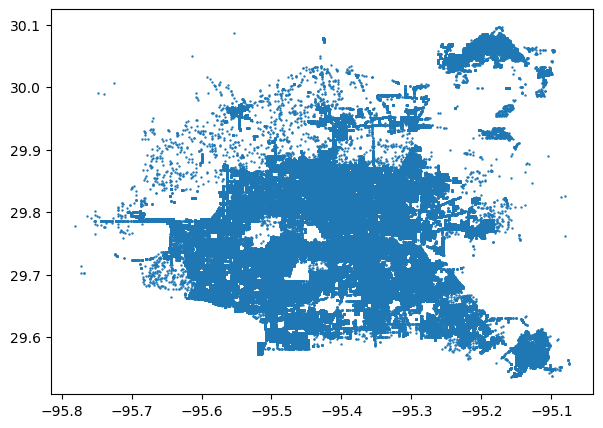

In [17]:
f = plt.figure(figsize=(7,5))
df = filt_data_2[['X', 'Y']]
plt.scatter('X', 'Y', data=df, s = 0.5)
plt.show()

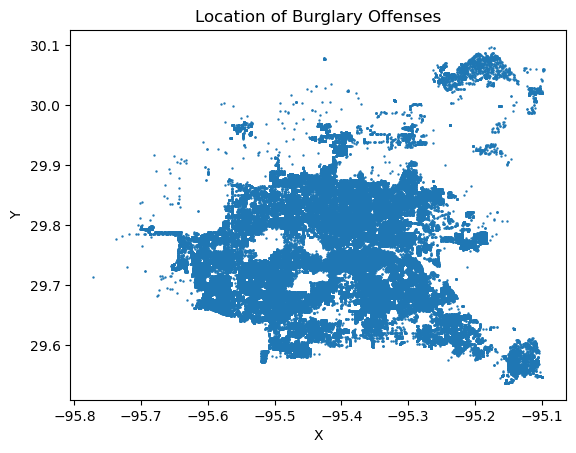

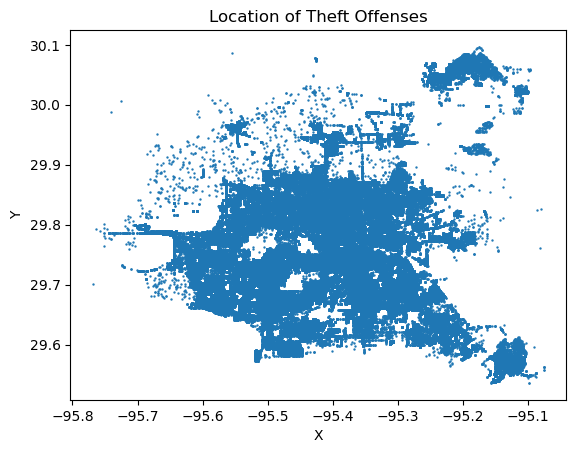

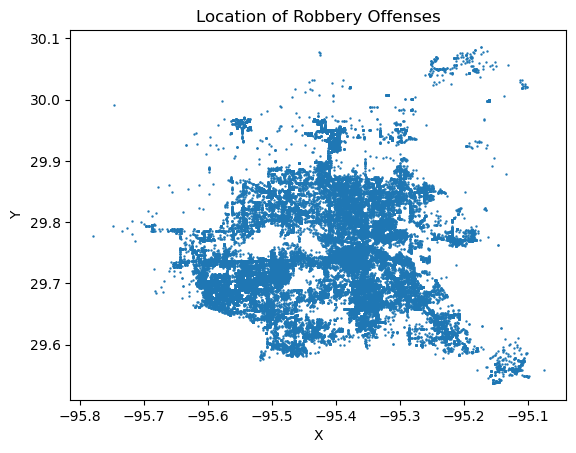

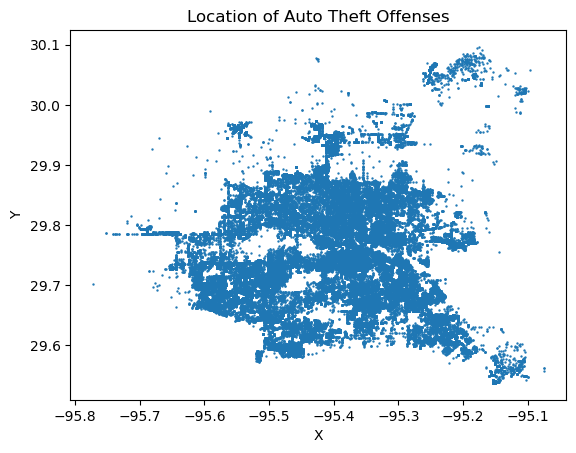

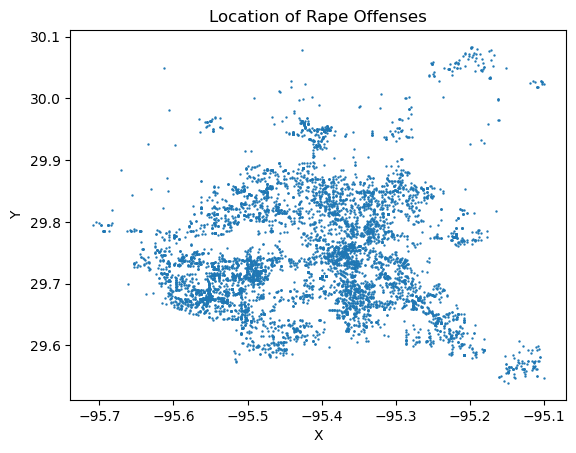

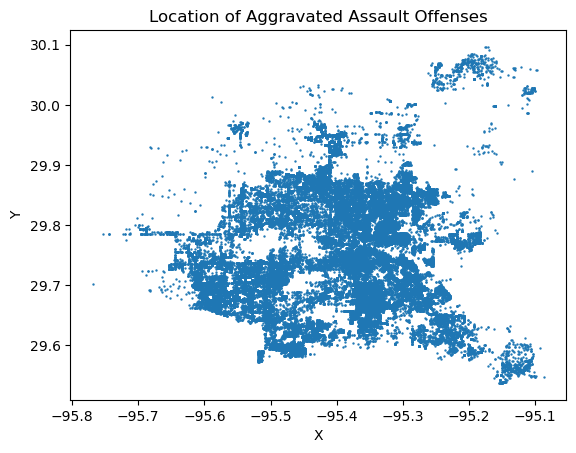

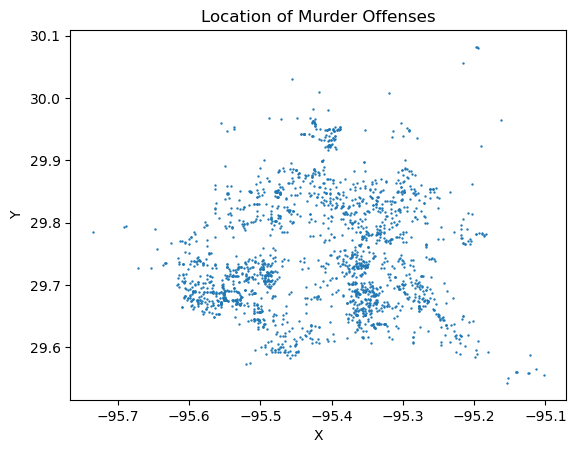

In [18]:
filt_data_2
for type in filt_data_2['Offense_Type'].unique():
    filt_by_off_type = filt_data_2[(filt_data_2['Offense_Type'] == type)]
    plt.scatter('X', 'Y', data = filt_by_off_type, s = 0.5)
    plt.xlabel("X")
    plt.ylabel("Y")
    plt.title("Location of " + type + " Offenses")
    plt.show()

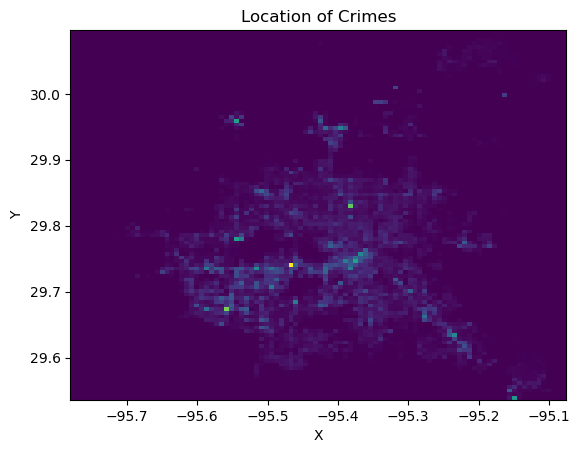

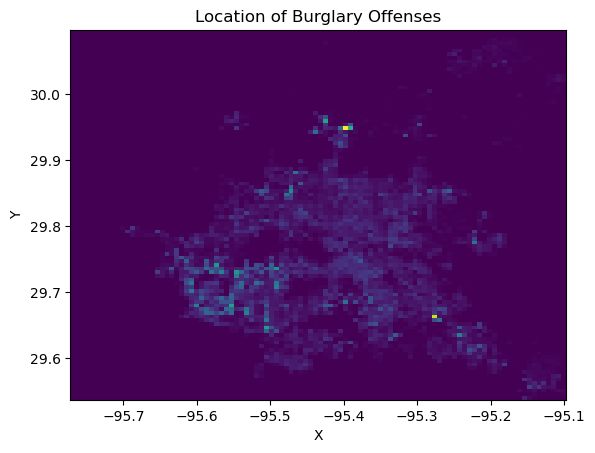

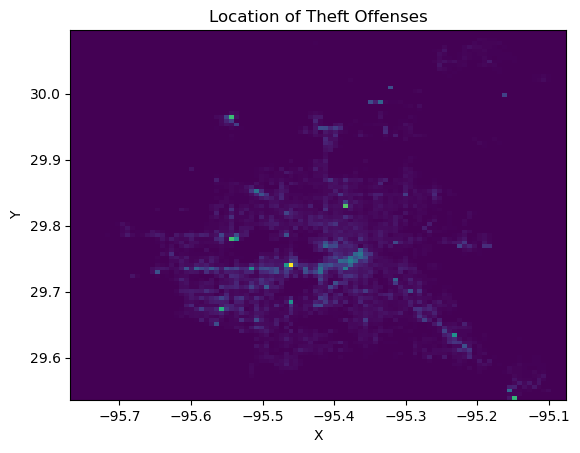

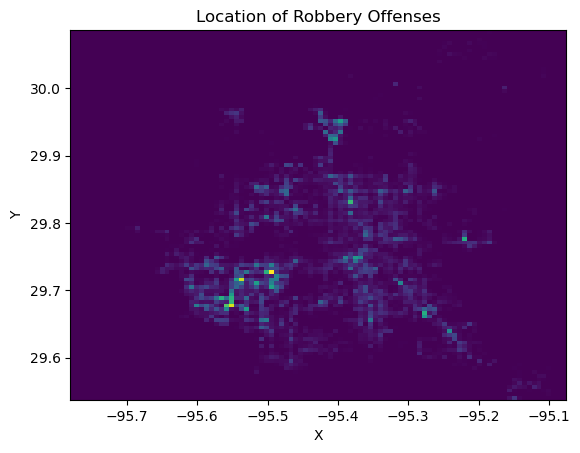

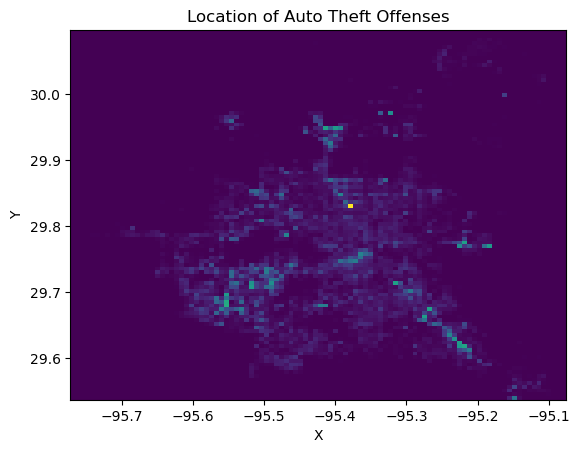

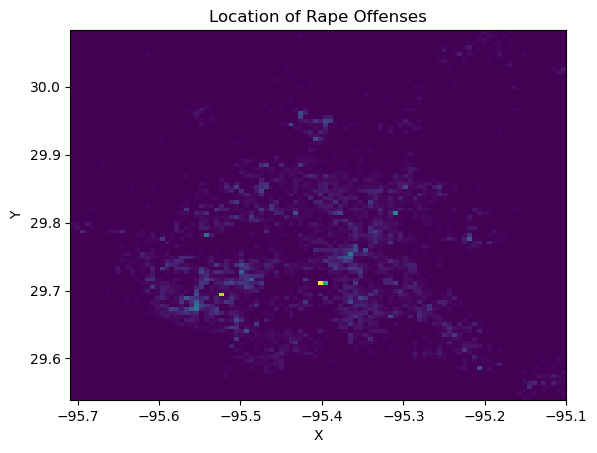

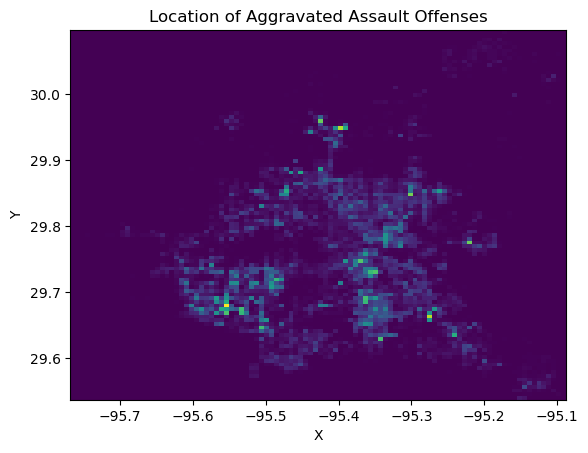

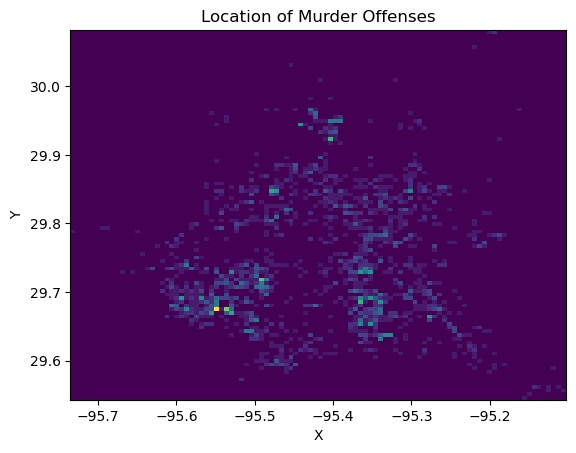

In [19]:
plt.hist2d('X', 'Y', data = filt_data_2, bins = 100)
plt.xlabel("X")
plt.ylabel("Y")
plt.title("Location of Crimes")
plt.show()
for type in filt_data_2['Offense_Type'].unique():
    filt_by_off_type = filt_data_2[(filt_data_2['Offense_Type'] == type)]
    plt.hist2d('X', 'Y', data = filt_by_off_type, bins = 100)
    plt.xlabel("X")
    plt.ylabel("Y")
    plt.title("Location of " + type + " Offenses")
    plt.show()

In [20]:
import folium
from folium.plugins import HeatMap

heatmap = folium.Map(location = (filt_data_2['Y'].mean(), filt_data_2['X'].mean()))

HeatMap(filt_data_2[["Y", "X"]].values.tolist()).add_to(heatmap)
heatmap



In [21]:
filt_data_2['Date_Reported'] = filt_data_2['Date_Reported'].astype("datetime64[ns]")
filt_data_2

/var/folders/_x/0sn_6qpd1213g88y3kkd3m6m0000gp/T/ipykernel_49127/2426479566.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filt_data_2['Date_Reported'] = filt_data_2['Date_Reported'].astype("datetime64[ns]")


,Location_Desc,Police_Beat,Street_Type,RecordID,Date_Reported,Offense_Type,Block_Range,Street_Prefix,Street_Name,Num_Offenses,...,X,Y,GEOID10,GEOID00,Police_Division,CTA_ID,CTA_Name,Geocoded,Location_Code,Hour
0,NaN,14D40,RD,1,NaT,Burglary,5600-5699,NaN,SELINSKY,1,...,-95.333268,29.637514,4.820133e+14,4.820133e+14,Southeast Division,K066,Minnetex,1,NaN,8
1,NaN,7C20,NaN,2,NaT,Theft,3900-3999,NaN,CAVALCADE,1,...,-95.331799,29.800081,4.820121e+14,4.820121e+14,Northeast Division,K004,Kashmere Gardens,1,NaN,11
2,NaN,13D40,PKWY,3,NaT,Theft,8500-8599,S,SAM HOUSTON,1,...,-95.516291,29.625560,4.820133e+14,4.820133e+14,Southwest Division,K070,Five Corners,1,NaN,15
3,NaN,18F40,RD,4,NaT,Robbery,2700-2799,NaN,DUNVALE,1,...,-95.514200,29.736820,4.820143e+14,4.820143e+14,Midwest Division,K080,Mid-West,1,NaN,14
4,RESTAURANT/CAFETERIA,24C60,PKWY,5,1914-09-08,Burglary,12700-12799,W,LAKE HOUSTON,1,...,-95.195466,29.924672,4.820125e+14,4.820125e+14,Kingwood Division,K106,Lake Houston,1,210,7
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1094202,MISC. BUSINESS (NON-SPECIFIC),9C40,ST,1094203,2017-12-31,Burglary,12700-12799,NaN,EAST,1,...,-95.208459,29.770717,4.820123e+14,4.820123e+14,Northeast Division,K054,Northshore,1,05Z,0
1094203,APARTMENT PARKING LOT,9C40,RD,1094204,2017-12-31,Theft,600-699,NaN,MAXEY RD,1,...,-95.218625,29.780813,4.820123e+14,4.820123e+14,Northeast Division,K054,Northshore,1,18A,14
1094204,SERVICE/GAS STATION,9C40,ST,1094205,2017-12-31,Theft,7600-7699,NaN,EAST,1,...,-95.290745,29.777468,4.820121e+14,4.820121e+14,Northeast Division,K005,Denver Harbor / Port Houston,1,23S,14
1094205,"ELECTRONICS STORE, ELECTRICAL SUP.",9C40,RD,1094206,2017-12-31,Robbery,1000-1099,NaN,FEDERAL,1,...,-95.215481,29.772798,4.820123e+14,4.820123e+14,Northeast Division,K054,Northshore,1,24E,17


In [22]:
filt_data_2['Date_Reported'].dt.year.value_counts()

Date_Reported
2010.0    134576
2013.0    128335
2012.0    125711
2011.0    125467
2014.0    119058
           ...  
2020.0         1
1975.0         1
1959.0         1
1986.0         1
2033.0         1
Name: count, Length: 71, dtype: int64

In [23]:
data_2009_2017 = filt_data_2[(filt_data_2['Date_Reported'] >= pd.Timestamp(2009,1,1)) & (filt_data_2['Date_Reported'] <= pd.Timestamp(2018,1,1))]
data_2009_2017

,Location_Desc,Police_Beat,Street_Type,RecordID,Date_Reported,Offense_Type,Block_Range,Street_Prefix,Street_Name,Num_Offenses,...,X,Y,GEOID10,GEOID00,Police_Division,CTA_ID,CTA_Name,Geocoded,Location_Code,Hour
1297,RESIDENCE/HOUSE,14D30,DR,1298,2009-01-01,Rape,5400-5499,NaN,HERON,1,...,-95.342211,29.659102,4.820133e+14,4.820133e+14,Southeast Division,K068,South Park,1,20R,0
1298,OTHER PARKING LOT,7C40,RD,1299,2009-01-01,Auto Theft,10500-10599,E,HARDY,1,...,-95.363379,29.866316,4.820122e+14,4.820122e+14,Northeast Division,K043,Eastex / Jensen,1,18O,12
1299,DRIVEWAY,2A10,ST,1300,2009-01-01,Auto Theft,4100-4199,NaN,BEGGS,1,...,-95.365623,29.797606,4.820121e+14,4.820121e+14,Central Division,K002,Near Northside,1,20D,0
1300,MISC. BUSINESS (NON-SPECIFIC),1A10,ST,1301,2009-01-01,Theft,600-699,NaN,JEFFERSON,1,...,-95.372735,29.752808,4.820110e+14,4.820110e+14,Central Division,K001,Downtown,1,05Z,12
1301,APARTMENT,18F40,DR,1302,2009-01-01,Theft,6400-6499,NaN,DEL MONTE,1,...,-95.498875,29.745726,4.820143e+14,4.820143e+14,Midwest Division,K081,Uptown,1,20A,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1094202,MISC. BUSINESS (NON-SPECIFIC),9C40,ST,1094203,2017-12-31,Burglary,12700-12799,NaN,EAST,1,...,-95.208459,29.770717,4.820123e+14,4.820123e+14,Northeast Division,K054,Northshore,1,05Z,0
1094203,APARTMENT PARKING LOT,9C40,RD,1094204,2017-12-31,Theft,600-699,NaN,MAXEY RD,1,...,-95.218625,29.780813,4.820123e+14,4.820123e+14,Northeast Division,K054,Northshore,1,18A,14
1094204,SERVICE/GAS STATION,9C40,ST,1094205,2017-12-31,Theft,7600-7699,NaN,EAST,1,...,-95.290745,29.777468,4.820121e+14,4.820121e+14,Northeast Division,K005,Denver Harbor / Port Houston,1,23S,14
1094205,"ELECTRONICS STORE, ELECTRICAL SUP.",9C40,RD,1094206,2017-12-31,Robbery,1000-1099,NaN,FEDERAL,1,...,-95.215481,29.772798,4.820123e+14,4.820123e+14,Northeast Division,K054,Northshore,1,24E,17


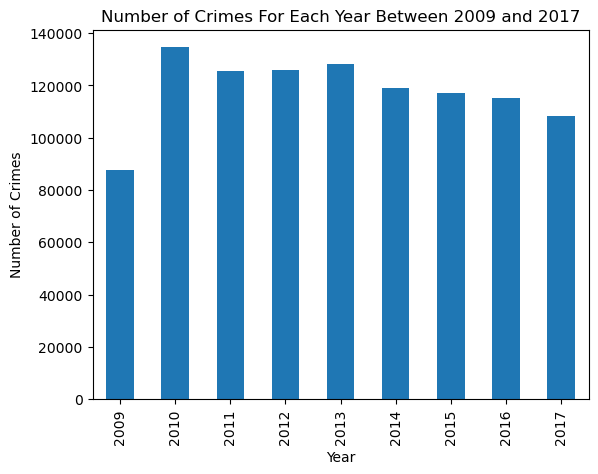

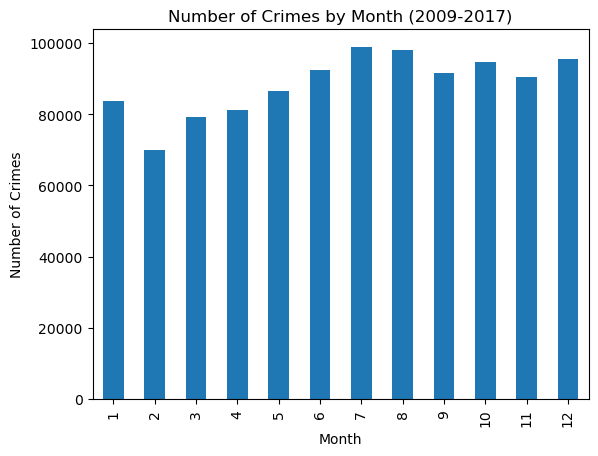

In [24]:
data_2009_2017['Date_Reported'].dt.year.value_counts().sort_index().plot(kind='bar')
plt.xlabel('Year')
plt.ylabel('Number of Crimes')
plt.title('Number of Crimes For Each Year Between 2009 and 2017')
plt.show()

data_2009_2017['Date_Reported'].dt.month.value_counts().sort_index().plot(kind='bar')
plt.xlabel('Month')
plt.ylabel('Number of Crimes')
plt.title('Number of Crimes by Month (2009-2017)')
plt.show()

In [25]:
data_2009_2017["Hour"].describe()

count    1.061862e+06
mean     1.310818e+01
std      6.435201e+00
min      0.000000e+00
25%      9.000000e+00
50%      1.400000e+01
75%      1.800000e+01
max      2.400000e+01
Name: Hour, dtype: float64

In [26]:
data_2009_2017["Hour"].unique()

array([ 0, 12,  8,  7,  9, 10, 19, 23,  4, 21,  2, 14, 22, 17,  1, 18, 16,
       13, 20, 15, 11,  6,  3,  5, 24])

In [27]:
rel_data = data_2009_2017[['Date_Reported', 'X', 'Y', 'Hour', 'Offense_Type']]
rel_data

,Date_Reported,X,Y,Hour,Offense_Type
1297,2009-01-01,-95.342211,29.659102,0,Rape
1298,2009-01-01,-95.363379,29.866316,12,Auto Theft
1299,2009-01-01,-95.365623,29.797606,0,Auto Theft
1300,2009-01-01,-95.372735,29.752808,12,Theft
1301,2009-01-01,-95.498875,29.745726,0,Theft
...,...,...,...,...,...
1094202,2017-12-31,-95.208459,29.770717,0,Burglary
1094203,2017-12-31,-95.218625,29.780813,14,Theft
1094204,2017-12-31,-95.290745,29.777468,14,Theft
1094205,2017-12-31,-95.215481,29.772798,17,Robbery


In [28]:
rel_data.loc[:, 'Month'] = rel_data['Date_Reported'].dt.month
rel_data.loc[:, 'Year'] = rel_data['Date_Reported'].dt.year
rel_data = rel_data[['X', 'Y', 'Hour', 'Month', 'Year', 'Offense_Type']]
rel_data

/var/folders/_x/0sn_6qpd1213g88y3kkd3m6m0000gp/T/ipykernel_49127/2299245363.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  rel_data.loc[:, 'Month'] = rel_data['Date_Reported'].dt.month
/var/folders/_x/0sn_6qpd1213g88y3kkd3m6m0000gp/T/ipykernel_49127/2299245363.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  rel_data.loc[:, 'Year'] = rel_data['Date_Reported'].dt.year


,X,Y,Hour,Month,Year,Offense_Type
1297,-95.342211,29.659102,0,1,2009,Rape
1298,-95.363379,29.866316,12,1,2009,Auto Theft
1299,-95.365623,29.797606,0,1,2009,Auto Theft
1300,-95.372735,29.752808,12,1,2009,Theft
1301,-95.498875,29.745726,0,1,2009,Theft
...,...,...,...,...,...,...
1094202,-95.208459,29.770717,0,12,2017,Burglary
1094203,-95.218625,29.780813,14,12,2017,Theft
1094204,-95.290745,29.777468,14,12,2017,Theft
1094205,-95.215481,29.772798,17,12,2017,Robbery


In [29]:
# encoded_data_1 = pd.get_dummies(rel_data, columns=['Offense_Type'])
encoded_data_1 = rel_data

In [30]:
encoded_data_1['Month_sin'] = np.sin(2 * np.pi * encoded_data_1['Month']/12)
encoded_data_1['Month_cos'] = np.cos(2 * np.pi * encoded_data_1['Month']/12)
encoded_data_1

,X,Y,Hour,Month,Year,Offense_Type,Month_sin,Month_cos
1297,-95.342211,29.659102,0,1,2009,Rape,5.000000e-01,0.866025
1298,-95.363379,29.866316,12,1,2009,Auto Theft,5.000000e-01,0.866025
1299,-95.365623,29.797606,0,1,2009,Auto Theft,5.000000e-01,0.866025
1300,-95.372735,29.752808,12,1,2009,Theft,5.000000e-01,0.866025
1301,-95.498875,29.745726,0,1,2009,Theft,5.000000e-01,0.866025
...,...,...,...,...,...,...,...,...
1094202,-95.208459,29.770717,0,12,2017,Burglary,-2.449294e-16,1.000000
1094203,-95.218625,29.780813,14,12,2017,Theft,-2.449294e-16,1.000000
1094204,-95.290745,29.777468,14,12,2017,Theft,-2.449294e-16,1.000000
1094205,-95.215481,29.772798,17,12,2017,Robbery,-2.449294e-16,1.000000


In [31]:
encoded_data_1['Hour_sin'] = np.sin(2 * np.pi * encoded_data_1['Hour']/24)
encoded_data_1['Hour_cos'] = np.cos(2 * np.pi * encoded_data_1['Hour']/24)
encoded_data_1

,X,Y,Hour,Month,Year,Offense_Type,Month_sin,Month_cos,Hour_sin,Hour_cos
1297,-95.342211,29.659102,0,1,2009,Rape,5.000000e-01,0.866025,0.000000e+00,1.000000
1298,-95.363379,29.866316,12,1,2009,Auto Theft,5.000000e-01,0.866025,1.224647e-16,-1.000000
1299,-95.365623,29.797606,0,1,2009,Auto Theft,5.000000e-01,0.866025,0.000000e+00,1.000000
1300,-95.372735,29.752808,12,1,2009,Theft,5.000000e-01,0.866025,1.224647e-16,-1.000000
1301,-95.498875,29.745726,0,1,2009,Theft,5.000000e-01,0.866025,0.000000e+00,1.000000
...,...,...,...,...,...,...,...,...,...,...
1094202,-95.208459,29.770717,0,12,2017,Burglary,-2.449294e-16,1.000000,0.000000e+00,1.000000
1094203,-95.218625,29.780813,14,12,2017,Theft,-2.449294e-16,1.000000,-5.000000e-01,-0.866025
1094204,-95.290745,29.777468,14,12,2017,Theft,-2.449294e-16,1.000000,-5.000000e-01,-0.866025
1094205,-95.215481,29.772798,17,12,2017,Robbery,-2.449294e-16,1.000000,-9.659258e-01,-0.258819


In [32]:
scaler = MinMaxScaler(feature_range=(-1, 1))
encoded_data_1[['X_scaled', 'Y_scaled']] = scaler.fit_transform(encoded_data_1[['X', 'Y']])
encoded_data_1

,X,Y,Hour,Month,Year,Offense_Type,Month_sin,Month_cos,Hour_sin,Hour_cos,X_scaled,Y_scaled
1297,-95.342211,29.659102,0,1,2009,Rape,5.000000e-01,0.866025,0.000000e+00,1.000000,0.243012,-0.561688
1298,-95.363379,29.866316,12,1,2009,Auto Theft,5.000000e-01,0.866025,1.224647e-16,-1.000000,0.182952,0.178123
1299,-95.365623,29.797606,0,1,2009,Auto Theft,5.000000e-01,0.866025,0.000000e+00,1.000000,0.176585,-0.067191
1300,-95.372735,29.752808,12,1,2009,Theft,5.000000e-01,0.866025,1.224647e-16,-1.000000,0.156405,-0.227132
1301,-95.498875,29.745726,0,1,2009,Theft,5.000000e-01,0.866025,0.000000e+00,1.000000,-0.201496,-0.252417
...,...,...,...,...,...,...,...,...,...,...,...,...
1094202,-95.208459,29.770717,0,12,2017,Burglary,-2.449294e-16,1.000000,0.000000e+00,1.000000,0.622512,-0.163192
1094203,-95.218625,29.780813,14,12,2017,Theft,-2.449294e-16,1.000000,-5.000000e-01,-0.866025,0.593668,-0.127146
1094204,-95.290745,29.777468,14,12,2017,Theft,-2.449294e-16,1.000000,-5.000000e-01,-0.866025,0.389039,-0.139089
1094205,-95.215481,29.772798,17,12,2017,Robbery,-2.449294e-16,1.000000,-9.659258e-01,-0.258819,0.602588,-0.155762


In [33]:
final_data = encoded_data_1[['X_scaled', 'Y_scaled', 'Hour_sin', 'Hour_cos', 'Month_sin', 'Month_cos', 'Offense_Type']]
final_data

,X_scaled,Y_scaled,Hour_sin,Hour_cos,Month_sin,Month_cos,Offense_Type
1297,0.243012,-0.561688,0.000000e+00,1.000000,5.000000e-01,0.866025,Rape
1298,0.182952,0.178123,1.224647e-16,-1.000000,5.000000e-01,0.866025,Auto Theft
1299,0.176585,-0.067191,0.000000e+00,1.000000,5.000000e-01,0.866025,Auto Theft
1300,0.156405,-0.227132,1.224647e-16,-1.000000,5.000000e-01,0.866025,Theft
1301,-0.201496,-0.252417,0.000000e+00,1.000000,5.000000e-01,0.866025,Theft
...,...,...,...,...,...,...,...
1094202,0.622512,-0.163192,0.000000e+00,1.000000,-2.449294e-16,1.000000,Burglary
1094203,0.593668,-0.127146,-5.000000e-01,-0.866025,-2.449294e-16,1.000000,Theft
1094204,0.389039,-0.139089,-5.000000e-01,-0.866025,-2.449294e-16,1.000000,Theft
1094205,0.602588,-0.155762,-9.659258e-01,-0.258819,-2.449294e-16,1.000000,Robbery


In [34]:
X_train, X_test, y_train, y_test = train_test_split(final_data[['X_scaled', 'Y_scaled', 'Hour_sin', 'Hour_cos', 'Month_sin', 'Month_cos']], final_data[['Offense_Type']], test_size=0.2, random_state=1)

X_train

,X_scaled,Y_scaled,Hour_sin,Hour_cos,Month_sin,Month_cos
740982,-0.096986,-0.280151,-9.659258e-01,-2.588190e-01,5.000000e-01,0.866025
585320,0.225594,-0.648581,-9.659258e-01,2.588190e-01,-8.660254e-01,0.500000
74206,-0.160171,-0.310362,1.224647e-16,-1.000000e+00,-5.000000e-01,0.866025
60426,0.425365,-0.414011,5.000000e-01,8.660254e-01,-8.660254e-01,0.500000
800969,0.590776,0.808855,1.000000e+00,6.123234e-17,-5.000000e-01,-0.866025
...,...,...,...,...,...,...
851284,0.470550,-0.272835,9.659258e-01,2.588190e-01,-2.449294e-16,1.000000
499333,0.153006,0.042324,-8.660254e-01,5.000000e-01,8.660254e-01,0.500000
478683,-0.284996,-0.622022,5.000000e-01,-8.660254e-01,-2.449294e-16,1.000000
499833,0.131025,0.050153,-1.000000e+00,-1.836970e-16,8.660254e-01,0.500000


In [35]:
lr_model_1 = LogisticRegression(multi_class='multinomial', solver='lbfgs', max_iter=1000)  # Adjust parameters as needed
lr_model_1.fit(X_train, y_train)

/Users/Mac/anaconda3/envs/deep/lib/python3.11/site-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


LogisticRegression(max_iter=1000, multi_class='multinomial')

In [36]:
y_pred_1 = lr_model_1.predict(X_test)

# Accuracy
print("Accuracy:", accuracy_score(y_test, y_pred_1))

# Confusion Matrix
print("Confusion Matrix:\n", confusion_matrix(y_test, y_pred_1))

# Classification Report
print("Classification Report:\n", classification_report(y_test, y_pred_1))

Accuracy: 0.5472117453725285
Confusion Matrix:
 [[     0      0      0      0      0      0  17431]
 [     0      0      0      0      0      0  21097]
 [     0      0      0      0      0      0  39538]
 [     0      0      0      0      0      0    369]
 [     0      0      0      0      0      0   1429]
 [     0      0      0      0      0      0  16296]
 [     0      0      0      0      0      0 116213]]


/Users/Mac/anaconda3/envs/deep/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/Mac/anaconda3/envs/deep/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Classification Report:
                     precision    recall  f1-score   support

Aggravated Assault       0.00      0.00      0.00     17431
        Auto Theft       0.00      0.00      0.00     21097
          Burglary       0.00      0.00      0.00     39538
            Murder       0.00      0.00      0.00       369
              Rape       0.00      0.00      0.00      1429
           Robbery       0.00      0.00      0.00     16296
             Theft       0.55      1.00      0.71    116213

          accuracy                           0.55    212373
         macro avg       0.08      0.14      0.10    212373
      weighted avg       0.30      0.55      0.39    212373



/Users/Mac/anaconda3/envs/deep/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [37]:
lr_model_2 = LogisticRegression(multi_class='multinomial', solver='lbfgs', max_iter=1000)  # Adjust parameters as needed
y_train = y_train.values.ravel()
sm = SMOTE(random_state=42)
X_res, y_res = sm.fit_resample(X_train, y_train)
lr_model_2.fit(X_res, y_res)

LogisticRegression(max_iter=1000, multi_class='multinomial')

In [38]:
y_pred_2 = lr_model_2.predict(X_test)

# Accuracy
print("Accuracy:", accuracy_score(y_test, y_pred_2))

# Confusion Matrix
print("Confusion Matrix:\n", confusion_matrix(y_test, y_pred_2))

# Classification Report
print("Classification Report:\n", classification_report(y_test, y_pred_2))

Accuracy: 0.2796965715980845
Confusion Matrix:
 [[ 2491    32  3264  5408   117  1739  4380]
 [ 2373    70  6345  4753   179  2230  5147]
 [ 3201   148 16517  6911   383  2826  9552]
 [   44     0    75   134     3    38    75]
 [  127     8   306   491    21   112   364]
 [ 1718    14  3228  5494   142  2317  3383]
 [12323   406 33739 19892   469 11534 37850]]
Classification Report:
                     precision    recall  f1-score   support

Aggravated Assault       0.11      0.14      0.13     17431
        Auto Theft       0.10      0.00      0.01     21097
          Burglary       0.26      0.42      0.32     39538
            Murder       0.00      0.36      0.01       369
              Rape       0.02      0.01      0.02      1429
           Robbery       0.11      0.14      0.12     16296
             Theft       0.62      0.33      0.43    116213

          accuracy                           0.28    212373
         macro avg       0.18      0.20      0.15    212373
      weig

In [39]:
# Here we're using Gini impurity as the criterion, but you could also use 'entropy'
decision_tree_1 = DecisionTreeClassifier(criterion='gini', random_state=1)

# Train the model using the training data
decision_tree_1.fit(X_train, y_train)

DecisionTreeClassifier(random_state=1)

In [40]:
# Predict the labels of the test set samples
y_pred_3 = decision_tree_1.predict(X_test)

# Accuracy
print("Accuracy:", accuracy_score(y_test, y_pred_3))

# Confusion Matrix
print("Confusion Matrix:\n", confusion_matrix(y_test, y_pred_3))

# Classification Report
print("Classification Report:\n", classification_report(y_test, y_pred_3))

Accuracy: 0.443559209504033
Confusion Matrix:
 [[ 3104  2162  3535    69   201  1824  6536]
 [ 2191  3552  3890    39   164  1722  9539]
 [ 4017  4304 13499    78   327  2747 14566]
 [   64    46    84     1     4    46   124]
 [  213   178   292     3    29   133   581]
 [ 2120  2036  2753    60   156  2462  6709]
 [ 8225 11458 16454   184   662  7677 71553]]
Classification Report:
                     precision    recall  f1-score   support

Aggravated Assault       0.16      0.18      0.17     17431
        Auto Theft       0.15      0.17      0.16     21097
          Burglary       0.33      0.34      0.34     39538
            Murder       0.00      0.00      0.00       369
              Rape       0.02      0.02      0.02      1429
           Robbery       0.15      0.15      0.15     16296
             Theft       0.65      0.62      0.63    116213

          accuracy                           0.44    212373
         macro avg       0.21      0.21      0.21    212373
      weigh

In [41]:
# Here we're using Gini impurity as the criterion, but you could also use 'entropy'
decision_tree_2 = DecisionTreeClassifier(criterion='gini', random_state=1)

# Train the model using the training data
decision_tree_2.fit(X_res, y_res)

DecisionTreeClassifier(random_state=1)

In [42]:
y_pred_4 = decision_tree_2.predict(X_test)

# Accuracy
print("Accuracy:", accuracy_score(y_test, y_pred_4))

# Confusion Matrix
print("Confusion Matrix:\n", confusion_matrix(y_test, y_pred_4))

# Classification Report
print("Classification Report:\n", classification_report(y_test, y_pred_4))

Accuracy: 0.36800817429710936
Confusion Matrix:
 [[ 3425  2490  3224   325   960  2484  4523]
 [ 2758  3909  3710   304   874  2499  7043]
 [ 5485  5678 11209   612  1786  4587 10181]
 [   86    51    66    10    21    57    78]
 [  262   206   276    21    90   177   397]
 [ 2551  2393  2574   247   790  2830  4911]
 [11644 14773 16664  1321  4176 10953 56682]]
Classification Report:
                     precision    recall  f1-score   support

Aggravated Assault       0.13      0.20      0.16     17431
        Auto Theft       0.13      0.19      0.15     21097
          Burglary       0.30      0.28      0.29     39538
            Murder       0.00      0.03      0.01       369
              Rape       0.01      0.06      0.02      1429
           Robbery       0.12      0.17      0.14     16296
             Theft       0.68      0.49      0.57    116213

          accuracy                           0.37    212373
         macro avg       0.20      0.20      0.19    212373
      wei

In [43]:
# Here we're using Gini impurity as the criterion, but you could also use 'entropy'
decision_tree_3 = DecisionTreeClassifier(criterion='gini', random_state=1, class_weight='balanced')

# Train the model using the training data
decision_tree_3.fit(X_res, y_res)

DecisionTreeClassifier(class_weight='balanced', random_state=1)

In [44]:
y_pred_5 = decision_tree_3.predict(X_test)

# Accuracy
print("Accuracy:", accuracy_score(y_test, y_pred_5))

# Confusion Matrix
print("Confusion Matrix:\n", confusion_matrix(y_test, y_pred_5))

# Classification Report
print("Classification Report:\n", classification_report(y_test, y_pred_5))

Accuracy: 0.36800817429710936
Confusion Matrix:
 [[ 3425  2490  3224   325   960  2484  4523]
 [ 2758  3909  3710   304   874  2499  7043]
 [ 5485  5678 11209   612  1786  4587 10181]
 [   86    51    66    10    21    57    78]
 [  262   206   276    21    90   177   397]
 [ 2551  2393  2574   247   790  2830  4911]
 [11644 14773 16664  1321  4176 10953 56682]]
Classification Report:
                     precision    recall  f1-score   support

Aggravated Assault       0.13      0.20      0.16     17431
        Auto Theft       0.13      0.19      0.15     21097
          Burglary       0.30      0.28      0.29     39538
            Murder       0.00      0.03      0.01       369
              Rape       0.01      0.06      0.02      1429
           Robbery       0.12      0.17      0.14     16296
             Theft       0.68      0.49      0.57    116213

          accuracy                           0.37    212373
         macro avg       0.20      0.20      0.19    212373
      wei